※본 커널은 캐글을 통해 공유된 "VinBigData Chest X-ray Abnormalities Detection"(https://www.kaggle.com/c/vinbigdata-chest-xray-abnormalities-detection) Competition 의 Notebooks 중

"Visual In-Depth EDA – VinBigData Competition Data"(https://www.kaggle.com/dschettler8845/visual-in-depth-eda-vinbigdata-competition-data) 의 내용을 기반으로 작성되었습니다.

<h1 style="text-align: center; font-family: Verdana; font-size: 32px; font-style: normal; font-weight: bold; text-decoration: none; text-transform: none; font-variant: small-caps; letter-spacing: 3px; color: #7b4f88; background-color: #ffffff;">VinBigData Chest X-ray Abnormalities Detection</h1>
<h2 style="text-align: center; font-family: Verdana; font-size: 24px; font-style: normal; font-weight: bold; text-decoration: underline; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;">Exploratory Data Analysis (EDA)</h2>
<h5 style="text-align: center; font-family: Verdana; font-size: 12px; font-style: normal; font-weight: bold; text-decoration: None; text-transform: none; letter-spacing: 1px; color: black; background-color: #ffffff;">CREATED BY: DARIEN SCHETTLER</h5>


<h2 style="font-family: Verdana; font-size: 24px; font-style: normal; font-weight: bold; text-decoration: none; text-transform: none; letter-spacing: 3px; color: navy; background-color: #ffffff;">TABLE OF CONTENTS</h2>

---

<h3 style="text-indent: 10vw; font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;"><a href="#imports">0&nbsp;&nbsp;&nbsp;&nbsp;IMPORTS</a></h3>

---

<h3 style="text-indent: 10vw; font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;"><a href="#background_information">1&nbsp;&nbsp;&nbsp;&nbsp;BACKGROUND INFORMATION</a></h3>

---

<h3 style="text-indent: 10vw; font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;"><a href="#setup">2&nbsp;&nbsp;&nbsp;&nbsp;SETUP</a></h3>

---

<h3 style="text-indent: 10vw; font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;"><a href="#helper_functions">3&nbsp;&nbsp;&nbsp;&nbsp;HELPER FUNCTIONS</a></h3>

---

<h3 style="text-indent: 10vw; font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;"><a href="#tabular_data">4&nbsp;&nbsp;&nbsp;&nbsp;TABULAR DATA</a></h3>

---

<h3 style="text-indent: 10vw; font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;"><a href="#image_data">5&nbsp;&nbsp;&nbsp;&nbsp;IMAGE DATA</a></h3>

---

<h3 style="text-indent: 10vw; font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;"><a href="#combining_annotations">6&nbsp;&nbsp;&nbsp;&nbsp;COMBINING ANNOTATIONS</a></h3>

---


#<a style="text-align: font-family: Verdana; font-size: 24px; font-style: normal; font-weight: bold; text-decoration: none; text-transform: none; letter-spacing: 3px; background-color: #ffffff; color: navy;" id="imports">0&nbsp;&nbsp;IMPORTS</a>

**# PIP Installs**

In [ ]:
!/opt/conda/bin/python3.7 -m pip install -q --upgrade pip      # Upgrade PIP

In [ ]:
!pip install -q pylibjpeg pylibjpeg-libjpeg pylibjpeg-openjpeg # Install/Upgrade PyDicom Dependencies

**# Imports**

In [ ]:
# Machine Learning and Data Science Imports
import tensorflow_probability as tfp
import tensorflow_datasets as tfds
import tensorflow_addons as tfa
import tensorflow_hub as hub
from skimage import exposure
import pandas as pd; pd.options.mode.chained_assignment = None
import numpy as np
import scipy

# Built In Imports
from datetime import datetime
from glob import glob
import warnings
import IPython
import urllib
import zipfile
import pickle
import shutil
import string
import math
import tqdm
import time
import os
import gc
import re

# Visualization Imports
from matplotlib.colors import ListedColormap
import matplotlib.patches as patches
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from PIL import Image
import matplotlib
import plotly
import PIL
import cv2

# PRESETS
FIG_FONT = dict(family="Helvetica, Arial", size=14, color="#7f7f7f")
LABEL_COLORS = [px.colors.label_rgb(px.colors.convert_to_RGB_255(x)) for x in sns.color_palette("Spectral", 15)]
LABEL_COLORS_WOUT_NO_FINDING = LABEL_COLORS[:8]+LABEL_COLORS[9:]

# Other Imports
from pydicom.pixel_data_handlers.util import apply_voi_lut
from tqdm.notebook import tqdm
import pydicom

print("\n... IMPORTS COMPLETE ...\n")


... IMPORTS COMPLETE ...



#<a style="text-align: font-family: Verdana; font-size: 24px; font-style: normal; font-weight: bold; text-decoration: none; text-transform: none; letter-spacing: 3px; color: navy; background-color: #ffffff;" id="image_data">5&nbsp;&nbsp;IMAGE DATA</a>


이미지 데이터는 DICOM 형식으로 저장되고 주석은 **`train_df`** 데이터 프레임에 저장됩니다.

<!--
Recall that the image data is stored in DICOM format and the annotations are stored in our **`train_df`** Dataframe.
-->

##<h3 style="text-align: font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;">5.1  CLASS TO HELP PARSE THE DATA </h3>


클래스는 데이터를 기능에 바인딩해야 할 때 매우 유용합니다. 이 경우 **`TrainData`**라는 클래스를 만들었습니다 (현재 초기 버전일 수 있으므로 다루기 어렵습니다).

나중에 메서드가 작동하는 방식에 대해 자세히 설명하겠습니다. 오늘은 각 메서드를 사용하여 해당 기능을 보여주는 출력을 간단히 생성하겠습니다.

<!--
Classes are very useful when we need to bind data to functionality. In this case, I have created a class (unwieldy as it may be currently in it's initial version) to help with that called **`TrainData`**.

I will get into the details of how the methods work at a later time... and for today I will simply generate the outputs using each method to show their functionality.
-->


In [ ]:
class TrainData():
    def __init__(self, df, train_dir, cmap="Spectral"):
        # Initialize
        self.df = df
        self.train_dir = train_dir
        
        # Visualization
        self.cmap = cmap
        self.pal = [tuple([int(x) for x in np.array(c)*(255,255,255)]) for c in sns.color_palette(cmap, 15)]
        self.pal.pop(8)
        
        # Store df components in individual numpy arrays for easy access based on index
        tmp_numpy = self.df.to_numpy()
        image_ids = tmp_numpy[0]
        class_ids = tmp_numpy[1]
        rad_ids = tmp_numpy[2]
        bboxes = tmp_numpy[3:]
        
        self.img_annotations = self.get_annotations(get_all=True)
        
        # Clean-Up
        del tmp_numpy; gc.collect();
        
        
    def get_annotations(self, get_all=False, image_ids=None, class_ids=None, rad_ids=None, index=None):
        """ TBD 
        
        Args:
            get_all (bool, optional): TBD
            image_ids (list of strs, optional): TBD
            class_ids (list of ints, optional): TBD
            rad_ids (list of strs, optional): TBD
            index (int, optional):
        
        Returns:
        
        
        """
        if not get_all and image_ids is None and class_ids is None and rad_ids is None and index is None:
            raise ValueError("Expected one of the following arguments to be passed:" \
                             "\n\t\t– `get_all`, `image_id`, `class_id`, `rad_id`, or `index`")
        # Initialize
        tmp_df = self.df.copy()
        
        if not get_all:
            if image_ids is not None:
                tmp_df = tmp_df[tmp_df.image_id.isin(image_ids)]
            if class_ids is not None:
                tmp_df = tmp_df[tmp_df.class_id.isin(class_ids)]
            if rad_ids is not None:
                tmp_df = tmp_df[tmp_df.rad_id.isin(rad_ids)]
            if index is not None:
                tmp_df = tmp_df.iloc[index]
            
        annotations = {image_id:[] for image_id in tmp_df.image_id.to_list()}
        for row in tmp_df.to_numpy():
            
            # Update annotations dictionary
            annotations[row[0]].append(dict(
                img_path=os.path.join(self.train_dir, row[0]+".dicom"),
                image_id=row[0],
                class_id=int(row[1]),
                rad_id=int(row[2][1:]),
            ))
            
            # Catch to convert float array to integer array
            if row[1]==14:
                annotations[row[0]][-1]["bbox"]=row[3:]
            else:
                annotations[row[0]][-1]["bbox"]=row[3:].astype(np.int32)
        return annotations
    
    def get_annotated_image(self, image_id, annots=None, plot=False, plot_size=(18,25), plot_title=""):
        if annots is None:
            annots = self.img_annotations.copy()
        
        if type(annots) != list:
            image_annots = annots[image_id]
        else:
            image_annots = annots
            
        img = cv2.cvtColor(dicom2array(image_annots[0]["img_path"]),cv2.COLOR_GRAY2RGB)
        for ann in image_annots:
            if ann["class_id"] != 14:
                img = draw_bboxes(img, 
                                ann["bbox"][:2], ann["bbox"][-2:], 
                                rgb=self.pal[ann["class_id"]], 
                                label=int_2_str[ann["class_id"]], 
                                opacity=0.08, line_thickness=4)
        if plot:
            plot_image(img, title=plot_title, figsize=plot_size)
        
        return img
    
    def plot_image_ids(self, image_id_list, height_multiplier=6, verbose=True):
        annotations = self.get_annotations(image_ids=image_id_list)
        annotated_imgs = []
        n = len(image_id_list)
        
        plt.figure(figsize=(20, height_multiplier*n))
        for i, (image_id, annots) in enumerate(annotations.items()):
            if i >= n:
                break
            if verbose:
                print(f".", end="")
            plt.subplot(n//2,2,i+1)
            plt.imshow(self.get_annotated_image(image_id, annots))
            plt.axis(False)
            plt.title(f"Image ID – {image_id}")
        plt.tight_layout(rect=[0, 0.03, 1, 0.97])
        plt.show()
        
    def plot_classes(self, class_list, n=4, height_multiplier=6, verbose=True):
        annotations = self.get_annotations(class_ids=class_list)
        annotated_imgs = []

        plt.figure(figsize=(20, height_multiplier*n))
        for i, (image_id, annots) in enumerate(annotations.items()):
            if i >= n:
                break
            if verbose:
                print(f".", end="")
            plt.subplot(n//2,2,i+1)
            plt.imshow(self.get_annotated_image(image_id, annots))
            plt.axis(False)
            plt.title(f"Image ID – {image_id}")
        plt.tight_layout(rect=[0, 0.03, 1, 0.97])
        plt.show()

    def plot_radiologists(self, rad_id_list, n=4, height_multiplier=6, verbose=True):
        annotations = self.get_annotations(rad_ids=rad_id_list)
        annotated_imgs = []

        plt.figure(figsize=(20, height_multiplier*n))
        for i, (image_id, annots) in enumerate(annotations.items()):
            if i >= n:
                break
            if verbose:
                print(f".", end="")
            plt.subplot(n//2,2,i+1)
            plt.imshow(self.get_annotated_image(image_id, annots))
            plt.axis(False)
            plt.title(f"Image ID – {image_id}")
        plt.tight_layout(rect=[0, 0.03, 1, 0.97])
        plt.show()

train_data = TrainData(train_df, TRAIN_DIR)

<b style="text-decoration: underline; font-family: Verdana;">PLOT IMAGES FROM THE CORRESPONDING IMAGE IDS</b>

Summary to be done later

---

More detail to come later

/opt/conda/lib/python3.7/site-packages/pydicom/pixel_data_handlers/pillow_handler.py:177: UserWarning:

The (0028,0101) 'Bits Stored' value (12-bit) doesn't match the JPEG 2000 data (16-bit). It's recommended that you change the 'Bits Stored' value



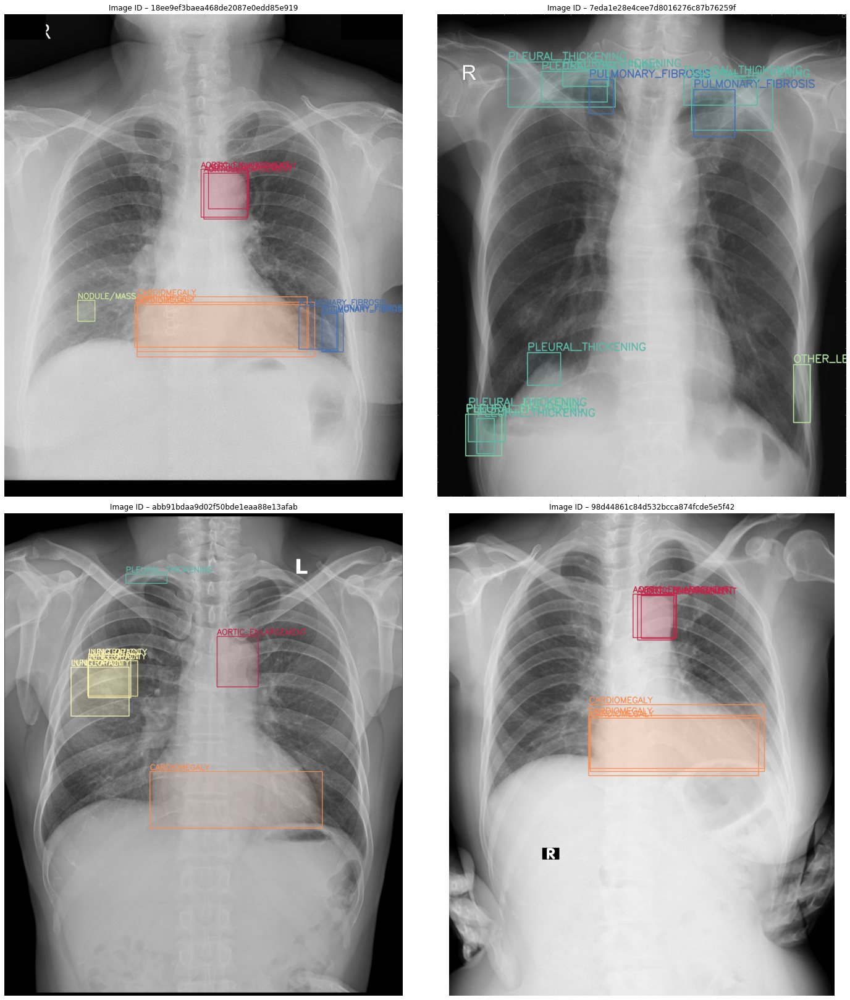

In [ ]:
IMAGE_ID_LIST = train_df[train_df.class_id!=14].image_id[25:29].to_list()
train_data.plot_image_ids(image_id_list=IMAGE_ID_LIST, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">PLOT IMAGES CONTAINING A SINGLE CLASS</b>

Summary to be done later... 

**참고 : 지정된 클래스에 대한 경계 상자 만 그려집니다 ... 아마도 향후 가능한 인수로 TBD(to be continued) 일 것입니다.**
<!--
**NOTE: Only the bounding boxes for the specified classes will be drawn... probably a TBD in the future as a possible arg**
-->
---

More detail to come later

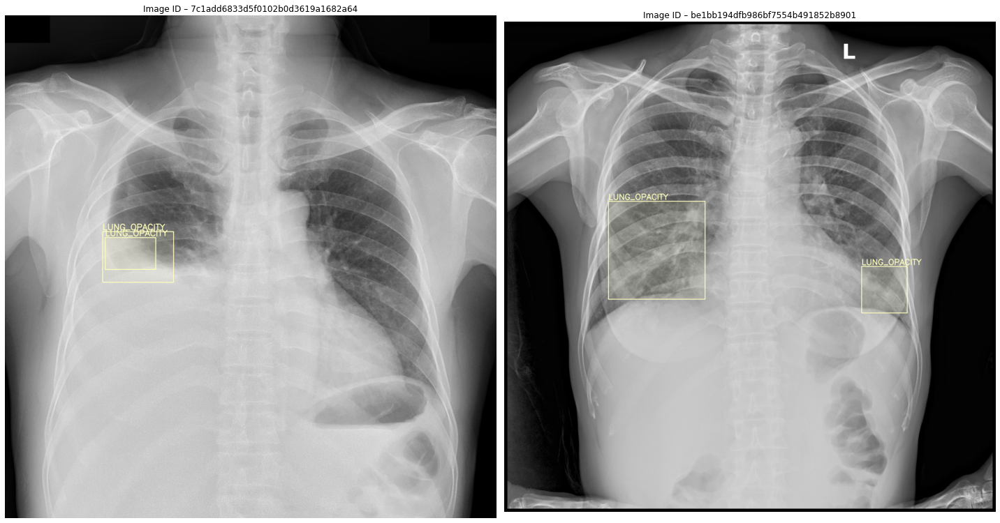

In [ ]:
train_data.plot_classes(class_list=[7,], n=2, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">PLOT IMAGES CONTAINING ONE OR MORE CLASSES FROM A LIST</b>

Summary to be done later... 

**참고 : 이미지에 모든 클래스가 포함될 필요는 없습니다 ... 잠재적 인 향후 개선 또는 옵션.**
<!--
**NOTE: Images need not contain ALL the classes... potential future improvement or option.**
-->

---

More detail to come later

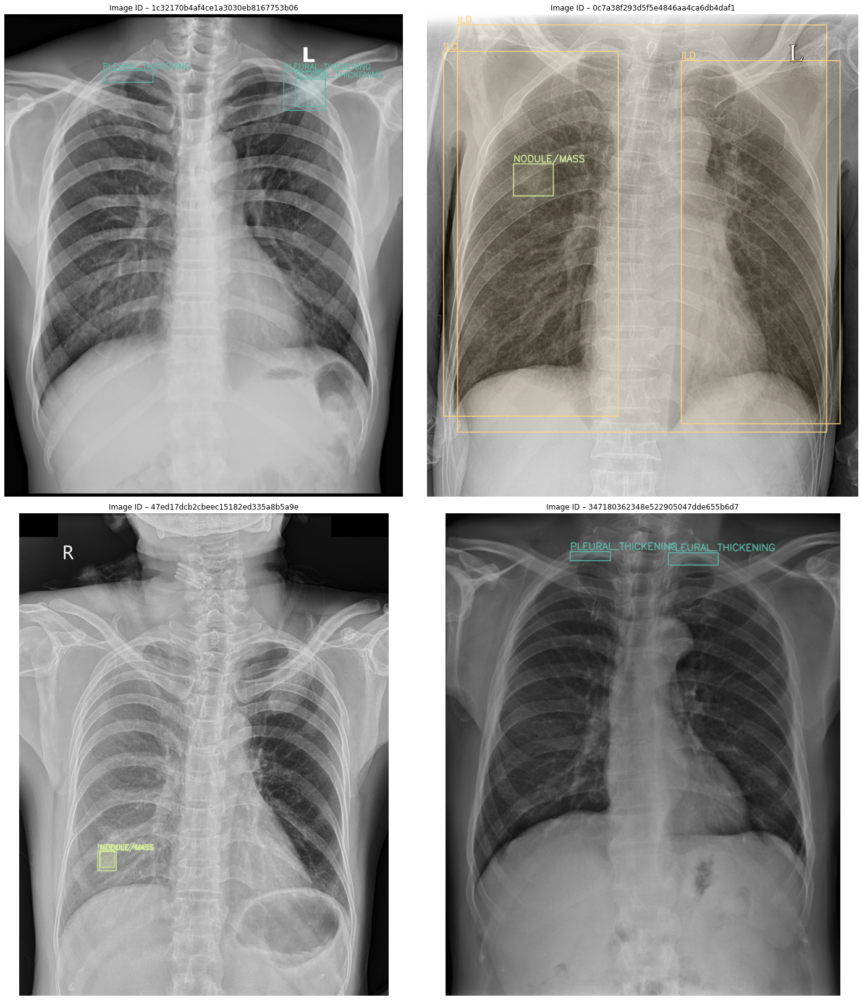

In [ ]:
train_data.plot_classes(class_list=[5,8,11], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">PLOT IMAGES ANNOTATED BY A SINGLE OR MULTIPLE RADIOLOGIST(S)</b>

Summary to be done later... 

**참고 : 클래스 기반 플로팅과 동일한 경고. 지정된 방사선 전문의가 주석을 단 경계 상자 만 표시됩니다** <br>
**참고 : 방사선 전문의는 종종 '조직 없음(No tissue)'에 주석을 달기 때문에 이미지에는 경계 상자가 포함되지 않을 수 있습니다.**
<!--
**NOTE: Same caveat as plotting based on class. Only bounding boxes annotated by the specified radiologist will be plotted**<br>
**NOTE: As radiologists often annotate `No tissue`, images may not contain ANY bounding boxes**
-->

---

More detail to come later

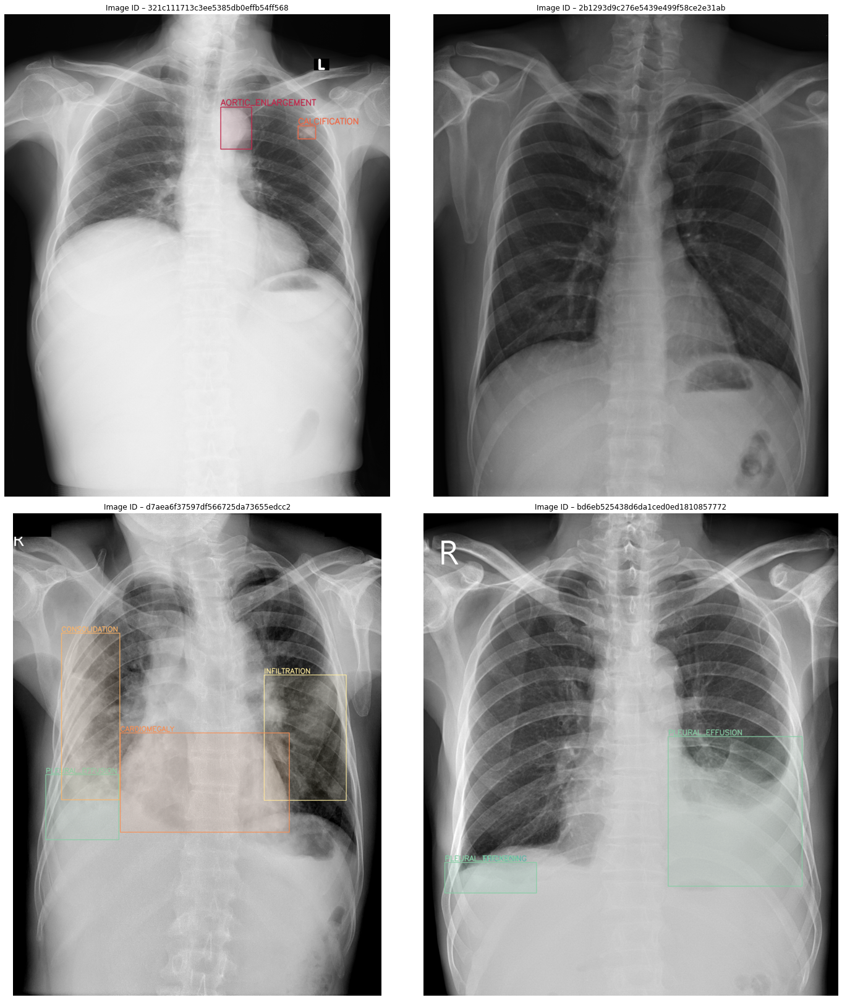

In [ ]:
train_data.plot_radiologists(rad_id_list=["R8"], verbose=False)

##<h3 style="text-align: font-family: Verdana; font-size: 20px; font-style: normal; font-weight: normal; text-decoration: none; text-transform: none; letter-spacing: 2px; color: navy; background-color: #ffffff;">5.2  VISUALIZE EACH ABNORMALITY </h3>


생성된 클래스를 활용하여 모든 클래스의 4 가지 예를 시각화합니다.

* 대동맥 확대(Aortic Enlargement) <i> <sub> (CLASS-ID : 0) </sub> </i>
* 무기폐(Atelectasis) <i> <sub> (CLASS-ID : 1) </sub> </i>
* 석회화(Calcification) <i> <sub> (CLASS-ID : 2) </sub> </i>
* 심비대(Cardiomegaly) <i> <sub> (CLASS-ID : 3) </sub> </i>
* 통합(Consolidation) <i> <sub> (CLASS-ID : 4) </sub> </i>
* ILD <i> <sub> (CLASS-ID : 5) </sub> </i>
* 침투(Infiltration) <i> <sub> (CLASS-ID : 6) </sub> </i>
* 폐 불투명도(Lung Opacity) <i> <sub> (CLASS-ID : 7) </sub> </i>
* 결절(Nodule) / 질량(Mass) <i> <sub> (CLASS-ID : 8) </sub> </i>
* 기타 병변(Other Lesion) <i> <sub> (CLASS-ID : 9) </sub> </i>
* 흉막 삼출(Pleural Effusion) <i> <sub> (CLASS-ID : 10) </sub> </i>
* 흉막 비후(Pleural Thickening) <i> <sub> (CLASS-ID : 11) </sub> </i>
* 기흉(Pneumothorax) <i> <sub> (CLASS-ID : 12) </sub> </i>
* 폐 섬유증(Pulmonary Fibrosis) <i> <sub> (CLASS-ID : 13) </sub> </i>
* 조직 없음(No Tissue Present) <i> <sub> (CLASS-ID : 14) </sub> </i>

<!--
We will leverage our created class to visualize 4 examples of every class...


* Aortic Enlargement <i><sub>(CLASS-ID: 0)</sub></i>
* Atelectasis <i><sub>(CLASS-ID: 1)</sub></i>
* Calcification <i><sub>(CLASS-ID: 2)</sub></i>
* Cardiomegaly <i><sub>(CLASS-ID: 3)</sub></i>
* Consolidation <i><sub>(CLASS-ID: 4)</sub></i>
* ILD <i><sub>(CLASS-ID: 5)</sub></i>
* Infiltration <i><sub>(CLASS-ID: 6)</sub></i>
* Lung Opacity <i><sub>(CLASS-ID: 7)</sub></i>
* Nodule/Mass <i><sub>(CLASS-ID: 8)</sub></i>
* Other Lesion <i><sub>(CLASS-ID: 9)</sub></i>
* Pleural Effusion <i><sub>(CLASS-ID: 10)</sub></i>
* Pleural Thickening <i><sub>(CLASS-ID: 11)</sub></i>
* Pneumothorax <i><sub>(CLASS-ID: 12)</sub></i>
* Pulmonary Fibrosis <i><sub>(CLASS-ID: 13)</sub></i>
* No Tissue Present <i><sub>(CLASS-ID: 14)</sub></i>
-->


<b style="text-decoration: underline; font-family: Verdana;">AORTIC ENLARGMENT - (0)</b>

Summary to be done later... 

---

More detail to come later

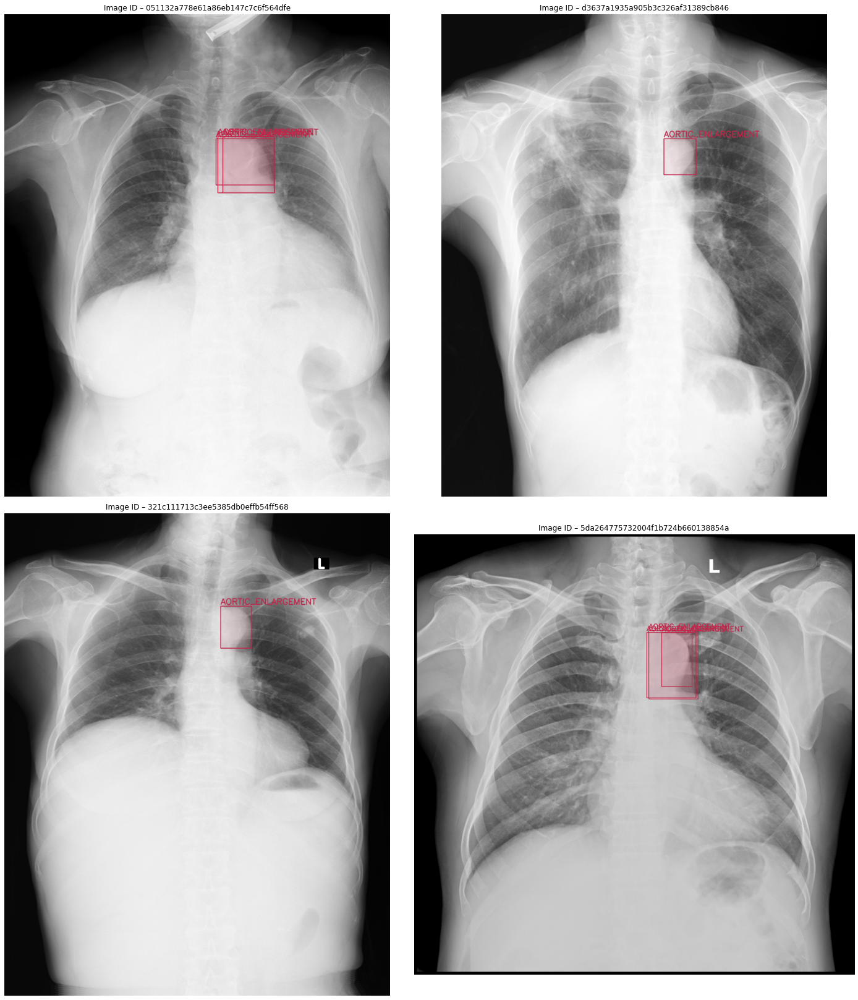

In [ ]:
train_data.plot_classes(class_list=[0,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">ATELECTASIS - (1)</b>

Summary to be done later... 

---

More detail to come later

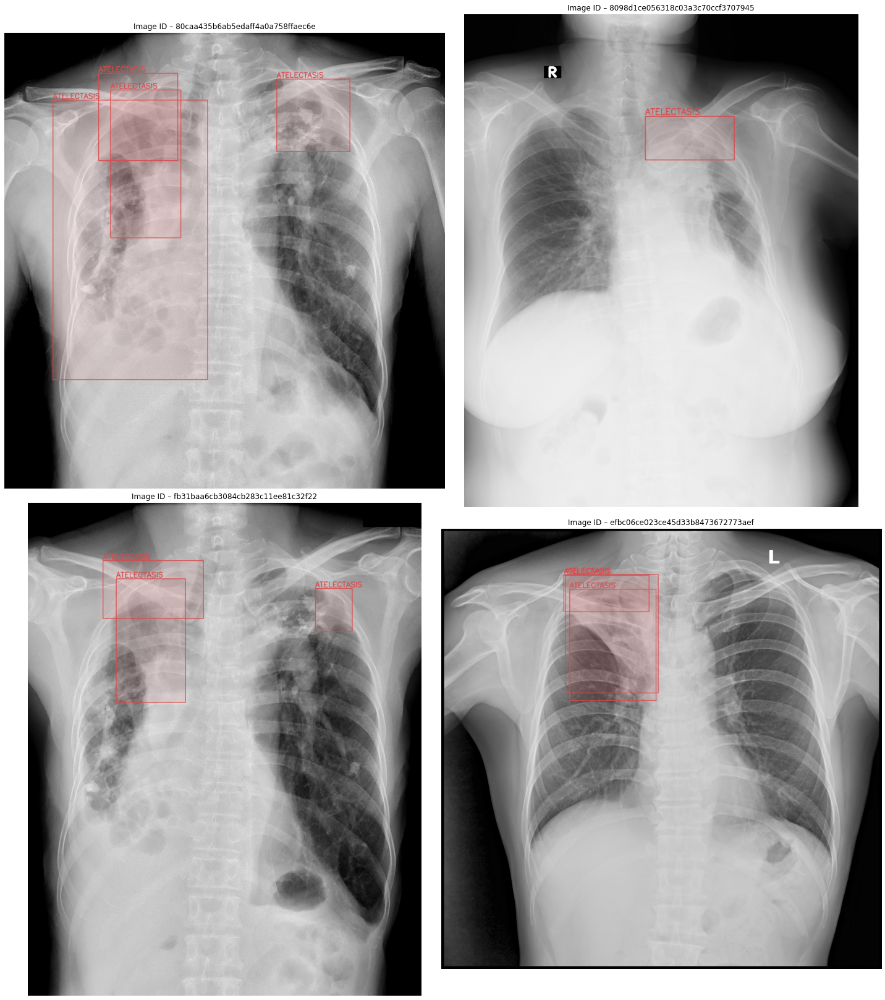

In [ ]:
train_data.plot_classes(class_list=[1,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">CALCIFICATION - (2)</b>

Summary to be done later... 

---

More detail to come later

/opt/conda/lib/python3.7/site-packages/pydicom/pixel_data_handlers/pillow_handler.py:177: UserWarning:

The (0028,0101) 'Bits Stored' value (14-bit) doesn't match the JPEG 2000 data (16-bit). It's recommended that you change the 'Bits Stored' value



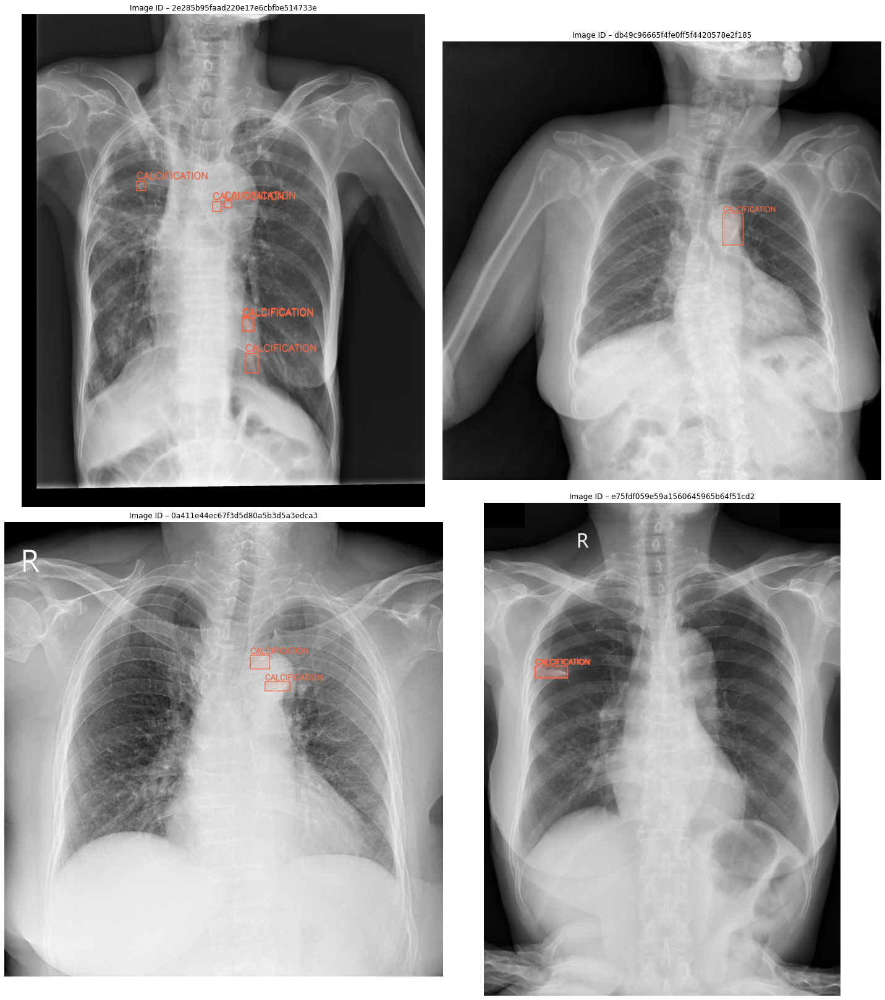

In [ ]:
train_data.plot_classes(class_list=[2,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">CARDIOMEGALY - (3)</b>

Summary to be done later... 

---

More detail to come later

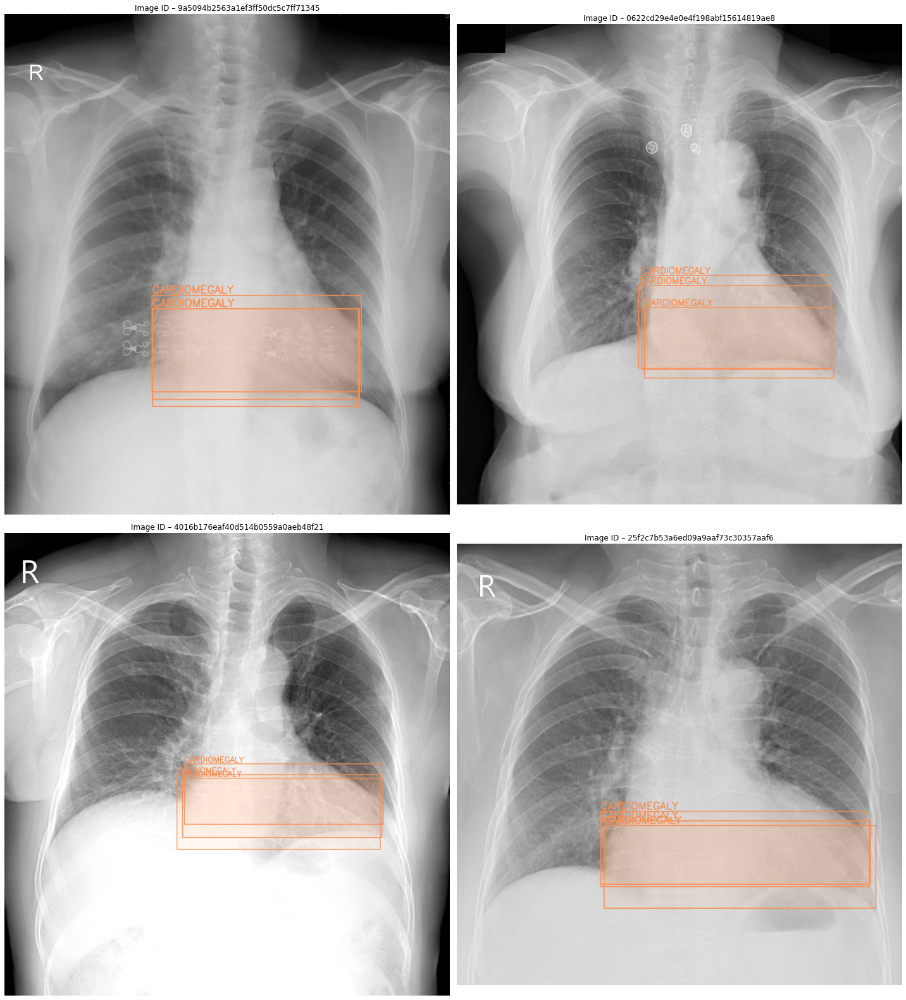

In [ ]:
train_data.plot_classes(class_list=[3,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">CONSOLIDATION - (4)</b>

Summary to be done later... 

---

More detail to come later

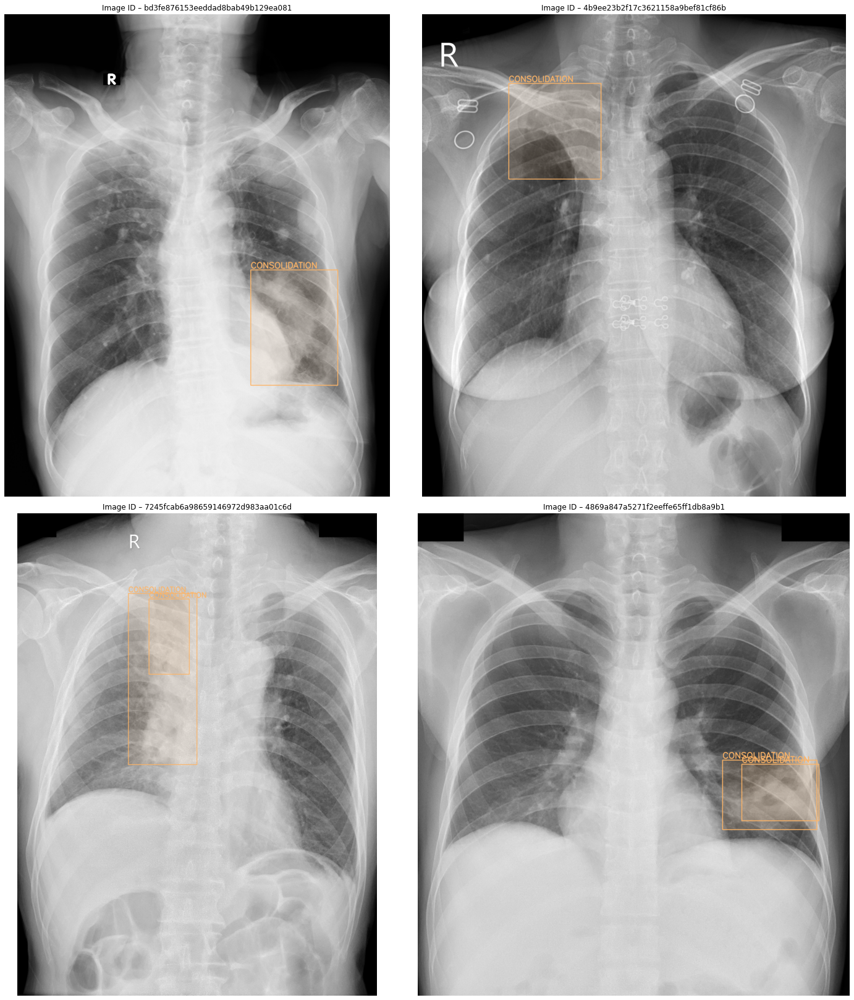

In [ ]:
train_data.plot_classes(class_list=[4,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">ILD - (5)</b>

Summary to be done later... 

---

More detail to come later

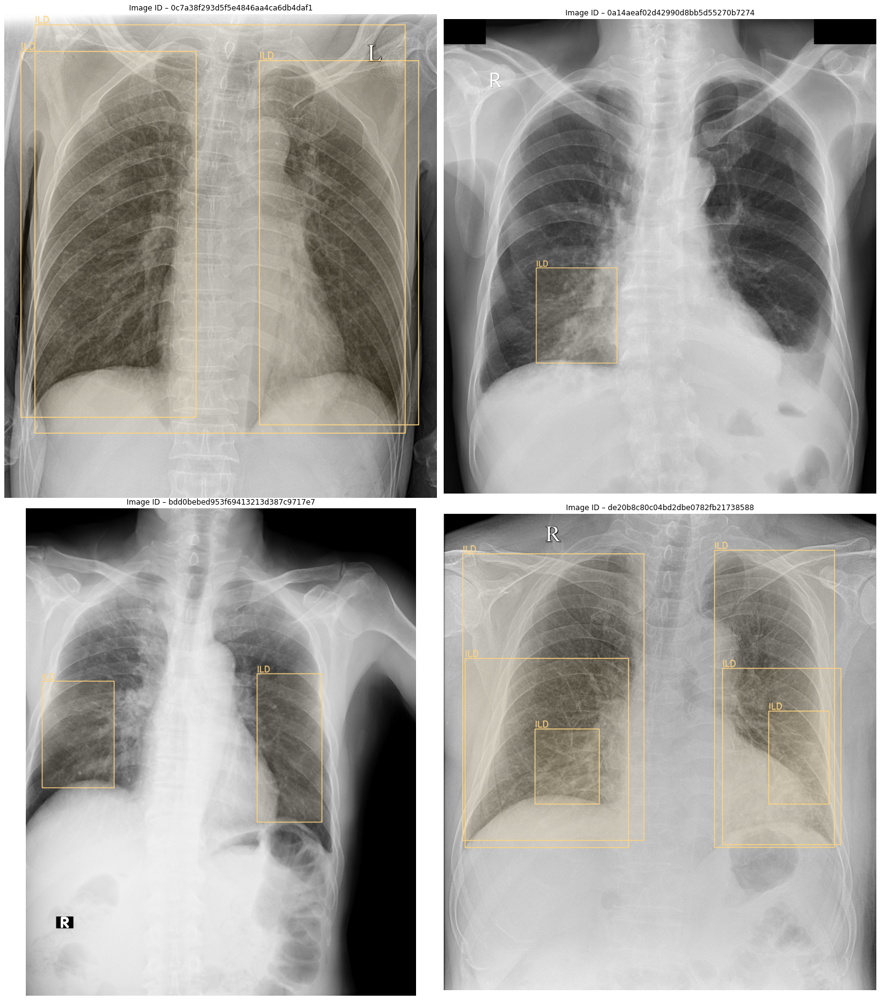

In [ ]:
train_data.plot_classes(class_list=[5,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">INFILTRATION - (6)</b>

Summary to be done later... 

---

More detail to come later

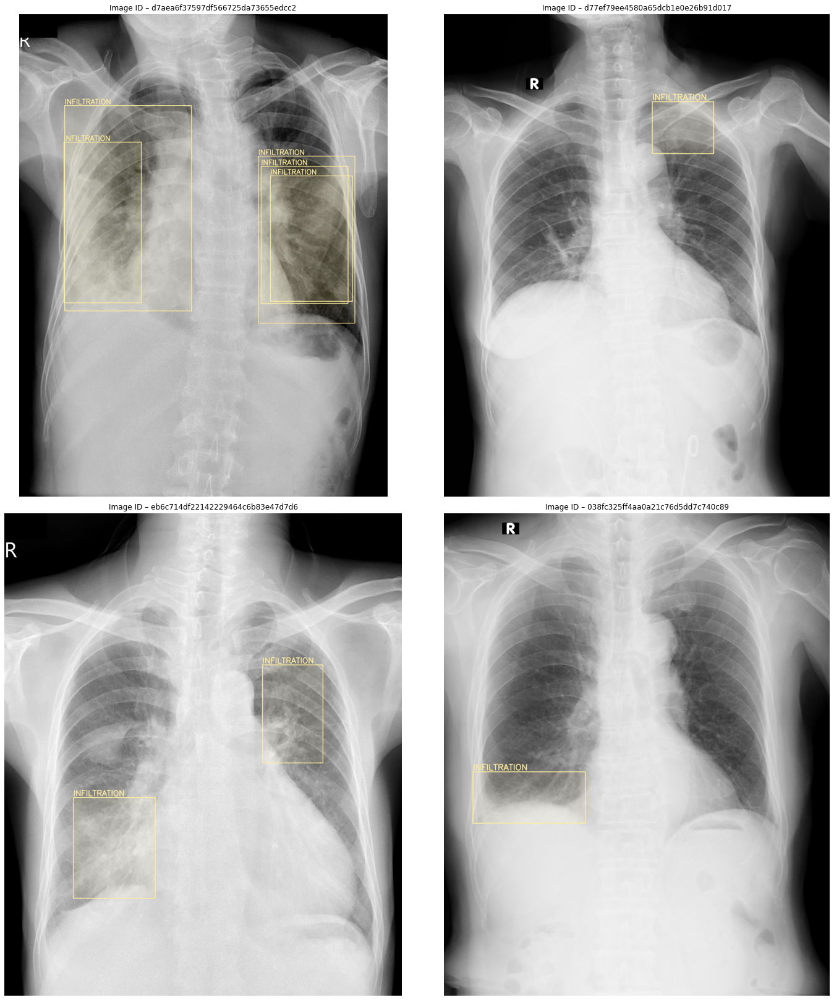

In [ ]:
train_data.plot_classes(class_list=[6,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">LUNG OPACITY - (7)</b>

Summary to be done later... 

---

More detail to come later

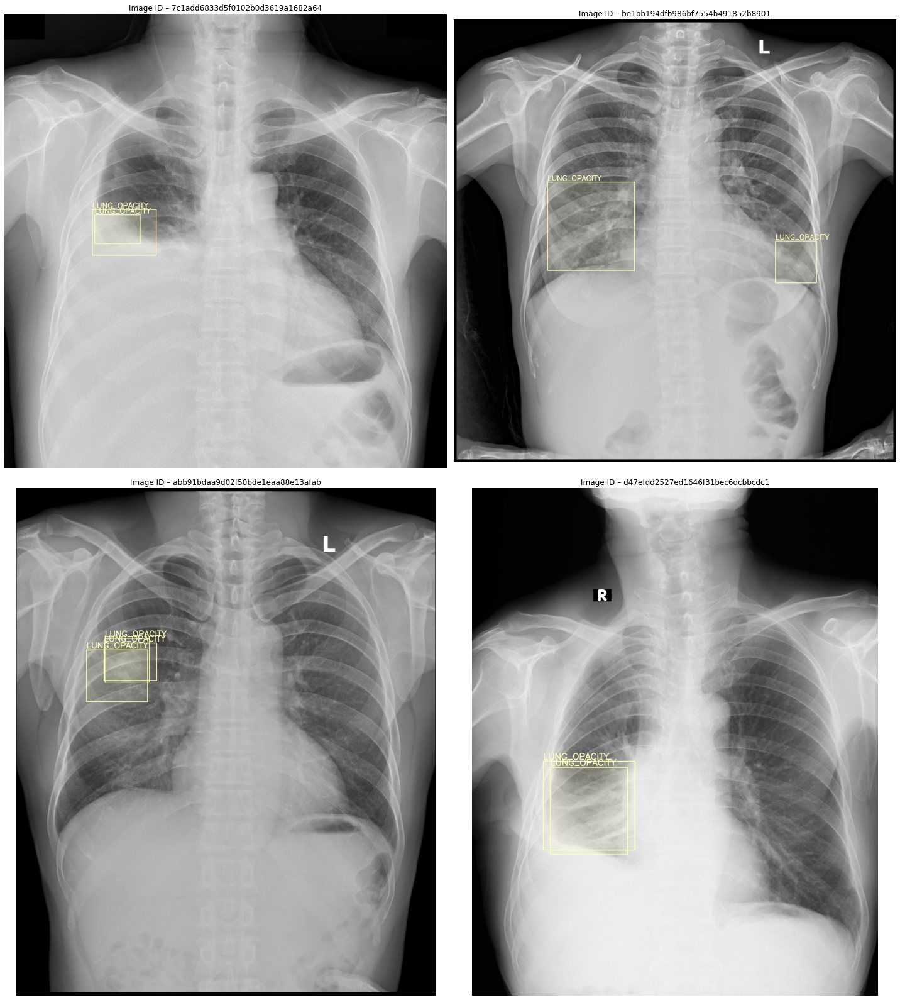

In [ ]:
train_data.plot_classes(class_list=[7,], n=4, verbose=False)

<b style="text-decoration: underline; font-family: Verdana;">NODULE/MASS - (8)</b>

Summary to be done later... 

---

More detail to come later

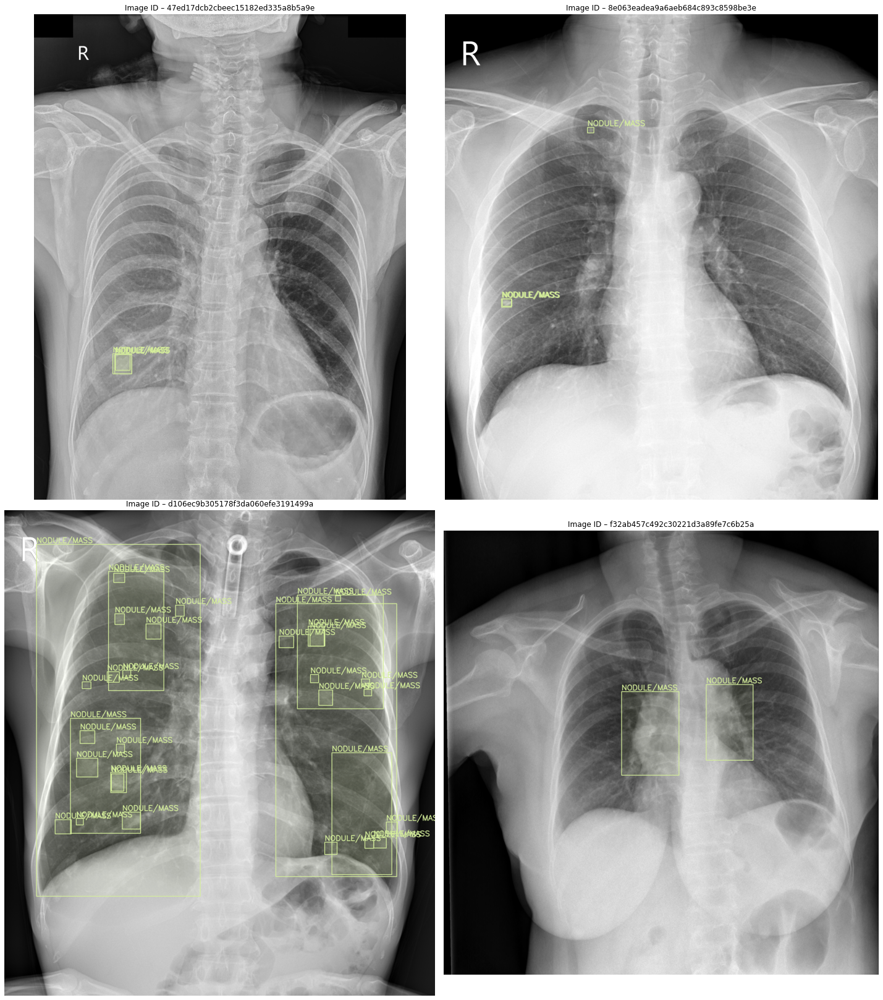

In [ ]:
train_data.plot_classes(class_list=[8,], n=4, verbose=False)